## Luna Melek Gulec

## My primary research question for this project is:

"What is the relationship between earthquake magnitude and depth, and how is the seismic intensity distributed across events?"

### This exploration focuses on:
- Quantitative Correlation: Examine the relationship between magnitude (`mag`) and depth (`depth`) for events, focusing mainly on earthquakes).

- Distributions: Analyze how magnitudes vary for shallow versus deeper events, and explore patterns in the engineered ordinal columns (`mag_ordinal` and `depth_ordinal`).

- Feature Relationships: Investigate the frequency of "minor", "moderate", etc., earthquakes (`mag_ordinal` and `depth_ordinal`) across network sources (`net`) to identify regions experiencing both shallow and high-magnitude events.

- Comparative Statistics: Compare mean and median depth for each magnitude category to understand how depth correlates with earthquake intensity.

## 0. Dataset and Environment Setup

In [1]:
import pandas as pd
import altair as alt
import numpy as np

In [2]:
earthquakes = pd.read_csv('../../data/processed/ordinal_data.csv')

## 1. Exploratory Data Analysis (EDA)

### A. Magnitude vs. Depth

#### Distribution of Earthquake Magnitudes by Event Type

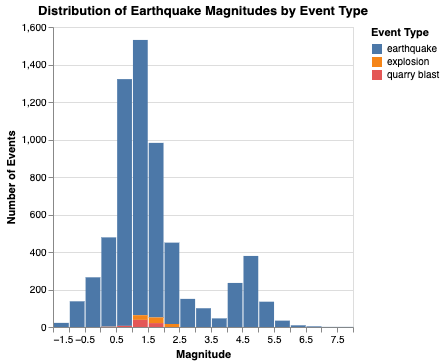

In [3]:
# disable the "max rows = 5000" setting
alt.data_transformers.disable_max_rows()

# adapted from tutorial 5 IMDB ratings binned histogram
Distribution_of_Earthquake_Magnitudes = alt.Chart(earthquakes).mark_bar().encode(
    alt.X('mag:Q', bin=alt.BinParams(maxbins=20), title='Magnitude'),
    alt.Y('count()', title='Number of Events'),
    alt.Color('type:N', title='Event Type')
).properties(title='Distribution of Earthquake Magnitudes by Event Type')

# to be able to view all charts in GitHub
alt.renderers.enable("mimetype")
Distribution_of_Earthquake_Magnitudes

- This layered histogram explores the distribution of earthquale magnitudes.
- There is one dominant peak with a magnitude of around 1.5, the magnitude of almost 1,600 events.
- It also reveals a slight right tail with a secondary, smaller peak near magnitude 5.0, though with many less events of around 400.
- To take this further, I wanted to view the magnitude distributions among the three event types in the dataset, and we can see that the overwhelming majority of events are earthquakes, followed by a small proportion of quarry blasts and explosions. The following code allows us to view this even further.

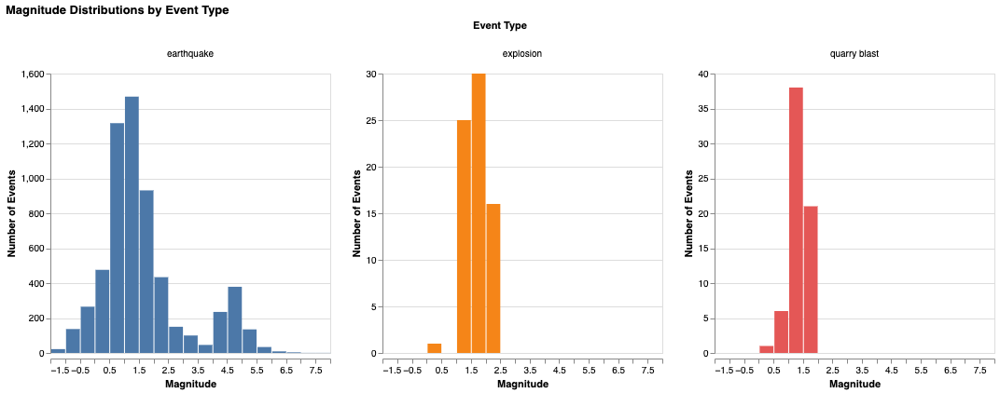

In [4]:
# view the three types separately, with their own scales
alt.Chart(earthquakes).mark_bar().encode(
    alt.X('mag:Q', bin=alt.BinParams(maxbins=20), title='Magnitude'),
    alt.Y('count()', title='Number of Events'),
    alt.Color('type:N', legend=None),
    alt.Column('type:N', title='Event Type')
).resolve_scale(y='independent').properties(title='Magnitude Distributions by Event Type')

- Faceting by event type shows that earthquakes and quarry blasts peak with a magnitude of around 1.5, whereas explosions peak slightly higher near 2.0.

#### Magnitude vs Depth by Event Type

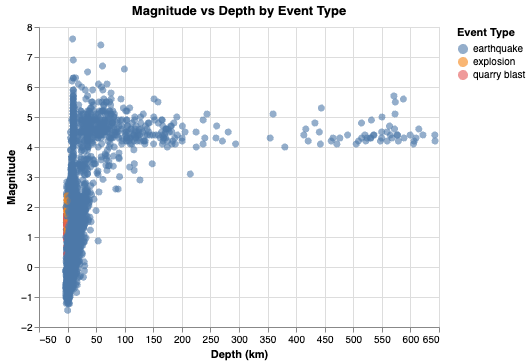

In [5]:
# alt.Chart(earthquakes).mark_circle(opacity=0.6, size=50).encode(
alt.Chart(earthquakes).mark_circle(opacity=0.6, size=50).encode(
    x=alt.X('depth:Q', title='Depth (km)'),
    y=alt.Y('mag:Q', title='Magnitude'),
    color=alt.Color('type:N', title='Event Type'),
    tooltip=['type', 'depth', 'mag']
).properties(width=400, height=300, title='Magnitude vs Depth by Event Type')

- This scatter plot aims to uncover the relationship between magnitude and depth, again coloured by event type.
- Focusing on earthquakes, as explosions and quarry blasts are few, depth typically stays under 200, with the majority of points clustering between depths 0-100, with varying magnitudes. However, depper events (up to 650 km) correpons to magnitudes of only 4-6.
    - Contrary to our initial expectations, the relationship between magnitude and depth is not strongly positive - i.e. deeper earthquakes are not necessarily stronger.
    - This could be due to the fact that most records have a magnitude of around 4-5.
    - This may also result from different tectonic regions or from detection bias (shallow quakes being more frequently recorded).

#### Relationship between magnitude and depth, coloured by mag_ordinal

In [6]:
# order the categories of mag_ordinal
ordered_mag_cat = [
    'Minor (<4.0)',
    'Light (4.0-4.9)',
    'Moderate (5.0-5.9)',
    'Strong (6.0-6.9)',
    'Major (>=7.0)'
]

earthquakes['mag_ordinal'] = pd.Categorical(
    earthquakes['mag_ordinal'],
    categories=ordered_mag_cat,
    ordered=True
)

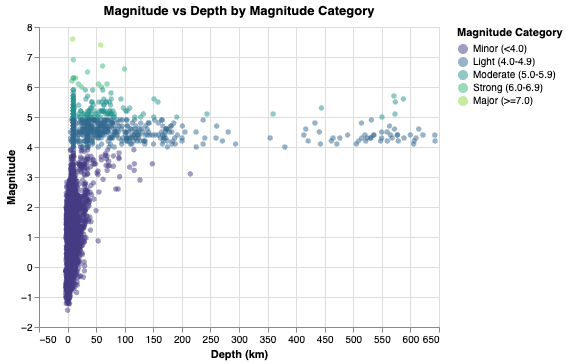

In [19]:
alt.Chart(earthquakes).mark_circle(opacity=0.5).encode(
    alt.X('depth:Q', title='Depth (km)'),
    alt.Y('mag:Q', title='Magnitude'),
    color=alt.Color(
        'mag_ordinal:O',
        scale=alt.Scale(domain=ordered_mag_cat, scheme='viridis'),
        legend=alt.Legend(title='Magnitude Category')
    ),
    tooltip=['mag', 'depth', 'mag_ordinal']
).properties(width=400, height=300, title='Magnitude vs Depth by Magnitude Category').interactive()

- Colouring the same depth and magnitude scatter plot by magnitude category (`mag_ordinal`) provides a clearer distribution, and we can see clearly that the majority of earthquakes are minor (magnitude cateogory under 4)

In [8]:
# order the categories of depth_ordinal
ordered_depth_cat = [
    'Negative (<0 km)',
    'Shallow (0-70 km)',
    'Intermediate (70-300 km)',
    'Deep (>300 km)'
]

earthquakes['depth_ordinal'] = pd.Categorical(
    earthquakes['depth_ordinal'],
    categories=ordered_depth_cat,
    ordered=True
)

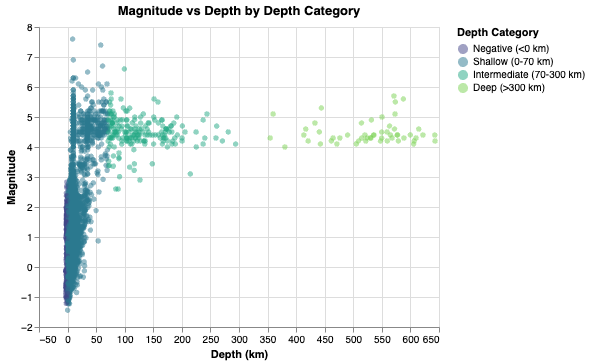

In [20]:
alt.Chart(earthquakes).mark_circle(opacity=0.5).encode(
    alt.X('depth:Q', title='Depth (km)'),
    alt.Y('mag:Q', title='Magnitude'),
    color=alt.Color(
        'depth_ordinal:O',
        scale=alt.Scale(domain=ordered_depth_cat, scheme='viridis'),
        legend=alt.Legend(title='Depth Category')
    ),
    tooltip=['mag', 'depth', 'depth_ordinal']
).properties(width=400, height=300, title='Magnitude vs Depth by Depth Category').interactive()

- Doing the same colouring by depth category (`depth_ordinal`) helps identify shallow vs. deep zones visually
- We can see that the majority of earthquakes have a shallow depth (0-70 km), with few as negative, and roughly equal amounts of intermediate (70-300 km) and deep (over 300 km)

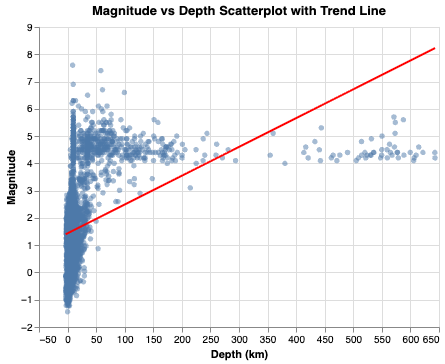

In [21]:
# adapted from tutorial 6 correlation scatter plot + trend line
scatter = alt.Chart(earthquakes).mark_circle(opacity=0.5).encode(
    alt.X('depth:Q', title='Depth (km)'),
    alt.Y('mag:Q', title='Magnitude'),
    tooltip=['mag', 'depth', 'type']
).interactive()
trend = scatter.transform_regression('depth', 'mag').mark_line(color='red')

(scatter + trend).properties(width=400, height=300, title='Magnitude vs Depth Scatterplot with Trend Line')

In [16]:
correlation_coef = earthquakes['depth'].corr(earthquakes['mag'])
print(f"Correlation coefficient: {correlation_coef:.3f}")

Correlation coefficient: 0.397


- The correlation between depth and magnitude is 0.397, which is weakly positive.
- While deeper earthquakes can be stronger on average, magnitude tends to depends on other geological factors (e.g. fault structure, tectonic stress).

- Insights for analysis: Are deeper earthquakes generally stronger? Deeper events may be less frequent but more powerful.

### B. Magnitude & Depth Categories (Ordinal Analysis)

#### Comparing depth_ordinal and mag_ordinal

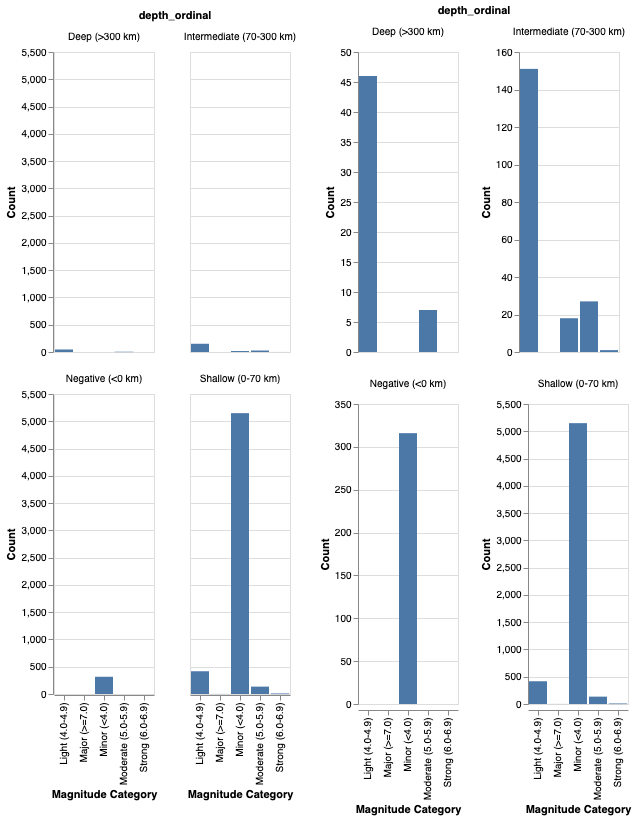

In [27]:
# # to view with independent scales
# shared = alt.Chart(earthquakes).mark_bar().encode(
#     alt.X('mag_ordinal:N', title='Magnitude Category'),
#     alt.Y('count()', title='Count'),
#     color='mag_ordinal:N'
# ).facet('mag_ordinal:N', columns=3)

# independent = alt.Chart(earthquakes).mark_bar().encode(
#     alt.X('mag_ordinal:N', title='Magnitude Category'),
#     alt.Y('count()', title='Count'),
#     color='mag_ordinal:N'
# ).facet('mag_ordinal:N', columns=3).resolve_scale(y='independent')

# shared | independent

shared = alt.Chart(earthquakes).mark_bar().encode(
    alt.X('mag_ordinal:N', title='Magnitude Category'),
    alt.Y('count()', title='Count')
).facet('depth_ordinal:N', columns=2)

independent = alt.Chart(earthquakes).mark_bar().encode(
    alt.X('mag_ordinal:N', title='Magnitude Category'),
    alt.Y('count()', title='Count')
).facet('depth_ordinal:N', columns=2).resolve_scale(y='independent')

shared | independent

- Faceting by `depth_ordinal` reveals that most events occur in shallow zones (0-70 km) and are classified as Minor (<4.0).
- As depth increases, the proportion of Moderate and Strong magnitudes slightly rises, though data volume decreases with greater depths.

#### Frequency of mag_ordinal or depth_ordinal by top 5 networks

In [31]:
top_nets = earthquakes['net'].value_counts().nlargest(5).index
top_nets

Index(['nc', 'ci', 'tx', 'us', 'av'], dtype='object', name='net')

- The top 5 largest networks are nc (Northern California), ci (Southern California), tx (Texas), us (USGS National Earthquake Information Center), av (Alaska Volcano Observatory)

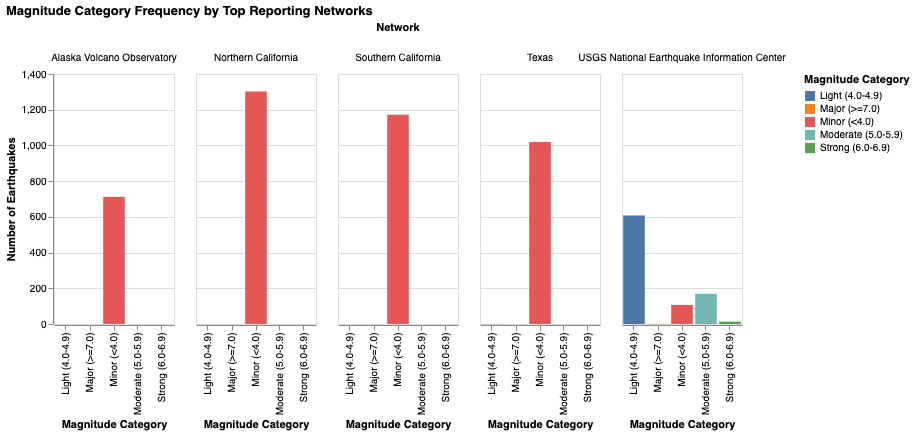

In [33]:
# filter dataset to only top networks
top_earthquakes = earthquakes[earthquakes['net'].isin(top_nets)].copy()

network_labels = {
    'av': 'Alaska Volcano Observatory',
    'ci': 'Southern California',
    'nc': 'Northern California',
    'tx': 'Texas',
    'us': 'USGS National Earthquake Information Center'
}

top_earthquakes['net_full'] = top_earthquakes['net'].map(network_labels)

alt.Chart(top_earthquakes).mark_bar().encode(
    x=alt.X('mag_ordinal:N', title='Magnitude Category'),
    y=alt.Y('count()', title='Number of Earthquakes'),
    color=alt.Color('mag_ordinal:N', title='Magnitude Category'),
    column=alt.Column('net_full:N', title='Network')
).properties(width=120, height=250, title='Magnitude Category Frequency by Top Reporting Networks')

- Comparing magnitude categories across major networks shows how reporting differs regionally.
- For example, California networks (NC, CI) have the highest volumes of Minor events.
- In contrast, USGS reports fewer but more varying events, possibly due to detection thresholds or location.

### C. Event Type Comparison

#### Magnitude Distribution by Event Type (check lectures to edit for outliers!!)

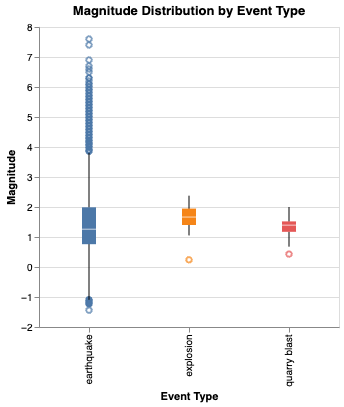

In [34]:
alt.Chart(earthquakes).mark_boxplot(extent=1.5).encode(
    x=alt.X('type:N', title='Event Type'),
    y=alt.Y('mag:Q', title='Magnitude'),
    color=alt.Color('type:N', legend=None),
    tooltip=['mag', 'mag_ordinal']
).properties(width=300, height=300, title='Magnitude Distribution by Event Type')

- Boxplots highlight how explosions have slightly higher average magnitudes, and both explosions and quarry blasts have smaller ranges, suggesting controlled energy release.
- Earthquakes display a wider spread and many outliers, specifcally clustered at higher magnitudes.

### D. Summary of EDA

- The dataset is dominated by minor to light shallow earthquakes.
- The correlation between magnitude and depth is weak but suggests that deeper quakes can be moderately stronger.
- Regional networks influence detection thresholds - local networks capture more low-magnitude events.
- Ordinal features simplify interpretation by grouping continuous values into meaningful categories, revealing that most earthquakes are shallow-minor events.

## 2. Analytic Tasks